In [1]:
import pandas as pd
import numpy as np
import time 


image.png

In [2]:
def fetch_race(rids, existing_results={}):
    race_results = existing_results.copy()
    for id in rids:
        if id in race_results.keys():
            continue
        try:
            time.sleep(0.2)
            url = f"https://db.sp.netkeiba.com/race/{id}"
            race_results[id] = pd.read_html(url)[0]
        except IndexError:
            continue
        except Exception as e:
            print(e)
            break
    return race_results

In [3]:
def process_race_id(id, n=1):
    data=dict()
    key_index_dict = {'year':(0,4),'course':(4,6), 'round':(6,8), 'day_of_round':(8,10), 'race_of_day':(10,12)}
    for k,v in key_index_dict.items():
        data[k]= n*[id[v[0]:v[1]]]
    return pd.DataFrame.from_dict(data)

In [4]:
process_race_id("201901010101", 5)

,year,course,round,day_of_round,race_of_day
0,2019,01,01,01,01
1,2019,01,01,01,01
2,2019,01,01,01,01
3,2019,01,01,01,01
4,2019,01,01,01,01


In [5]:
pd.DataFrame.from_dict(process_race_id("201901010101",2))

,year,course,round,day_of_round,race_of_day
0,2019,01,01,01,01
1,2019,01,01,01,01


In [6]:
def reshape_odds(url, n=1):
    df=pd.read_html(url)[1]
    df.columns=['type','result_num','return','popularity']
    df = df.groupby(['type']).agg(tuple).applymap(list).reset_index()
    df['result']= df[[x for x in df.columns if x!='type']].to_dict(orient='records')

    df=df.drop([x for x in df.columns if not x in ['type','result']], axis=1)
    df.index = pd.Index([0]*len(df))
    df = df.pivot(columns=['type'])
    # # res = pd.DataFrame(np.repeat(df.iloc[0,:],n))
    df.columns = df.columns.droplevel()
    res = df.loc[df.index.repeat(n)].reset_index(drop=True)

    return res


In [7]:
reshape_odds("https://db.sp.netkeiba.com/race/201901010101", 8)

type,3連単,3連複,ワイド,単勝,枠連,複勝,馬単,馬連
0,"{'result_num': ['1→3→4'], 'return': ['3,560円']...","{'result_num': ['1-3-4'], 'return': ['1,610円']...","{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p..."
1,"{'result_num': ['1→3→4'], 'return': ['3,560円']...","{'result_num': ['1-3-4'], 'return': ['1,610円']...","{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p..."
2,"{'result_num': ['1→3→4'], 'return': ['3,560円']...","{'result_num': ['1-3-4'], 'return': ['1,610円']...","{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p..."
3,"{'result_num': ['1→3→4'], 'return': ['3,560円']...","{'result_num': ['1-3-4'], 'return': ['1,610円']...","{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p..."
4,"{'result_num': ['1→3→4'], 'return': ['3,560円']...","{'result_num': ['1-3-4'], 'return': ['1,610円']...","{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p..."
5,"{'result_num': ['1→3→4'], 'return': ['3,560円']...","{'result_num': ['1-3-4'], 'return': ['1,610円']...","{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p..."
6,"{'result_num': ['1→3→4'], 'return': ['3,560円']...","{'result_num': ['1-3-4'], 'return': ['1,610円']...","{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p..."
7,"{'result_num': ['1→3→4'], 'return': ['3,560円']...","{'result_num': ['1-3-4'], 'return': ['1,610円']...","{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p..."


In [8]:
fetch_race(["201901010101"])["201901010101"].join(process_race_id("201901010101", 9)).join(reshape_odds("https://db.sp.netkeiba.com/race/201901010101", 9), lsuffix='_odd', rsuffix='_return')

,着順,枠番,馬番,馬名,性齢,斤量,騎手,タイム,着差,タイム指数,...,day_of_round,race_of_day,3連単,3連複,ワイド,単勝_return,枠連,複勝,馬単,馬連
0,1,1,1,ゴルコンダ,牡2,54,ルメール,1:48.3,NaN,90,...,01,01,"{'result_num': ['1→3→4'], 'return': ['3,560円']...","{'result_num': ['1-3-4'], 'return': ['1,610円']...","{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p..."
1,2,3,3,プントファイヤー,牡2,54,岩田康誠,1:50.1,大,**,...,01,01,"{'result_num': ['1→3→4'], 'return': ['3,560円']...","{'result_num': ['1-3-4'], 'return': ['1,610円']...","{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p..."
2,3,4,4,ラグリマスネグラス,牡2,51,団野大成,1:50.9,5,**,...,01,01,"{'result_num': ['1→3→4'], 'return': ['3,560円']...","{'result_num': ['1-3-4'], 'return': ['1,610円']...","{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p..."
3,4,8,9,キタノコドウ,牡2,51,菅原明良,1:51.5,3.1/2,**,...,01,01,"{'result_num': ['1→3→4'], 'return': ['3,560円']...","{'result_num': ['1-3-4'], 'return': ['1,610円']...","{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p..."
4,5,5,5,ネモフィラブルー,牡2,54,川島信二,1:51.7,1.1/2,**,...,01,01,"{'result_num': ['1→3→4'], 'return': ['3,560円']...","{'result_num': ['1-3-4'], 'return': ['1,610円']...","{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p..."
5,6,8,8,マイネルラクスマン,牡2,54,丹内祐次,1:52.1,2.1/2,**,...,01,01,"{'result_num': ['1→3→4'], 'return': ['3,560円']...","{'result_num': ['1-3-4'], 'return': ['1,610円']...","{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p..."
6,7,2,2,サンモンテベロ,牝2,54,黛弘人,1:52.5,2.1/2,**,...,01,01,"{'result_num': ['1→3→4'], 'return': ['3,560円']...","{'result_num': ['1-3-4'], 'return': ['1,610円']...","{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p..."
7,8,7,7,エスカレーション,牝2,54,藤岡佑介,1:52.5,アタマ,**,...,01,01,"{'result_num': ['1→3→4'], 'return': ['3,560円']...","{'result_num': ['1-3-4'], 'return': ['1,610円']...","{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p..."
8,9,6,6,セイウンジュリア,牝2,54,池添謙一,1:52.6,クビ,**,...,01,01,"{'result_num': ['1→3→4'], 'return': ['3,560円']...","{'result_num': ['1-3-4'], 'return': ['1,610円']...","{'r

In [ ]:
def fetch_race1(rids, existing_results={}):
    race_results = existing_results.copy() 
    for id in rids:
        if id in race_results.keys():
            continue
        try:
            time.sleep(0.2)
            url = f"https://db.sp.netkeiba.com/race/{id}"
            race_results[id] = pd.read_html(url)[0]
        except IndexError:
            continue
        except Exception as e:
            print(e)
            break
    return race_results

In [ ]:
def preprocessing(results):
    df = results.copy()

    # 着順に数字以外の文字列が含まれているものを取り除く
    df = df[~(df["着順"].astype(str).str.contains("\D"))]
    df["着順"] = df["着順"].astype(int)

    # 性齢を性と年齢に分ける
    df["sex"] = df["性齢"].map(lambda x: str(x)[0])
    df["age"] = df["性齢"].map(lambda x: str(x)[1:]).astype(int)

    # 馬体重を体重と体重変化に分ける
    df["体重"] = df["馬体重"].str.split("(", expand=True)[0].astype(int)
    df["体重変化"] = df["馬体重"].str.split("(", expand=True)[1].str[:-1].astype(int)

    # データをint, floatに変換
    df["単勝_odd"] = df["単勝_odd"].astype(float)

    # 不要な列を削除
    df.drop(["タイム", "着差", "調教師", "性齢", "馬体重"], axis=1, inplace=True)

    return df

In [ ]:
preprocessing(fetch_race(["201901010101"])["201901010101"].join(process_race_id("201901010101", 9)).join(reshape_odds("https://db.sp.netkeiba.com/race/201901010101", 9), lsuffix='_odd'))

,着順,枠番,馬番,馬名,斤量,騎手,タイム指数,通過,上り,単勝_odd,...,ワイド,単勝,枠連,複勝,馬単,馬連,性,年齢,体重,体重変化
0,1,1,1,ゴルコンダ,54,ルメール,90,1-1-1-1,36.5,1.4,...,"{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p...",牡,2,518,-16
1,2,3,3,プントファイヤー,54,岩田康誠,**,2-2-2-2,38.2,3.5,...,"{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p...",牡,2,496,-8
2,3,4,4,ラグリマスネグラス,51,団野大成,**,2-4-3-3,38.8,46.6,...,"{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p...",牡,2,546,6
3,4,8,9,キタノコドウ,51,菅原明良,**,8-8-8-7,38.5,56.8,...,"{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p...",牡,2,458,-8
4,5,5,5,ネモフィラブルー,54,川島信二,**,5-6-6-6,38.9,140.3,...,"{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p...",牡,2,436,0
5,6,8,8,マイネルラクスマン,54,丹内祐次,**,5-2-3-3,40.1,9.7,...,"{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p...",牡,2,480,8
6,7,2,2,サンモンテベロ,54,黛弘人,**,7-8-7-7,39.6,114.7,...,"{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p...",牝,2,450,2
7,8,7,7,エスカレーション,54,藤岡佑介,**,8-6-8-9,39.5,26.1,...,"{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p...",牝,2,448,-4
8,9,6,6,セイウンジュリア,54,池添謙一,**,4-5-5-5,40.3,16.4,...,"{'result_num': ['1-3', '1-4', '3-4'], 'return'...","{'result_num': ['1'], 'return': ['140円'], 'pop...","{'result_num': ['1-3'], 'return': ['190円'], 'p...","{'result_num': ['1', '3', '4'], 'return': ['11...","{'result_num': ['1→3'], 'return': ['290円'], 'p...","{'result_num': ['1-3'], 'return': ['190円'], 'p...",牝,2,470,0


In [ ]:
import requests
from bs4 import BeautifulSoup as bs
import bs4
import re
import datetime

In [ ]:
def fetch_race_meta(url, n):
    html = requests.get(url)
    html.encoding = 'EUC-JP'
    soup = bs4.BeautifulSoup(html.text, 'html.parser')
    tag = soup.find('div', attrs={'class': 'data_intro'})
    res = dict()
    if isinstance(tag, bs4.element.Tag):
        infos=re.findall(r'\w+',
                        tag.find_all('p')[0].text + tag.find_all('p')[1].text)
        for info in infos:
            if info in ['芝','ダート','障害']:
                res['field_type'] = info
            if info in ['良','稍重', '重', '不良']:
                res['ground_condition'] = info
            if info in ['曇', '晴', '雨', '小雪', '雪','小雨']:
                res['weather']= info
            if '年' in info and '月' in info:
                res['date']= datetime.datetime.strptime(info, '%Y年%m月%d日').date()
        df = pd.DataFrame(res,index=[0])
        df = df.loc[df.index.repeat(n)].reset_index(drop=True)
        return  df
    else:
        raise RuntimeError("can not find the right tag")

In [ ]:
fetch_race_meta("https://db.netkeiba.com/race/201906010101", 9)

['ダ右1200m',
 '天候',
 '晴',
 'ダート',
 '良',
 '発走',
 '09',
 '55',
 '2019年1月5日',
 '1回中山1日目',
 '3歳未勝利',
 '指',
 '馬齢']

In [21]:
from package.data import RaceData

In [2]:
rd = RaceData(201906010101)

In [3]:
rd.fetch_data()

,rank,lane_num,horse_num,horse_name,load_weight,jockey_name,time,rank_first_odd,popularity,sex,age,horse_weight,horse_weight_diff,norm_horse_weight,norm_load_weight,race_id,weather,field_type,ground_condition,date
0,1,5,9,サニークラウド,56,マーフィ,0 days 00:01:12.900000,3.9,2,牡,3,500,14,0.837838,1.0,201906010101,晴,ダート,良,2019-01-05
1,2,7,14,リゼ,52,横山武史,0 days 00:01:13,76.2,11,牝,3,448,10,0.135135,0.2,201906010101,晴,ダート,良,2019-01-05
2,3,5,10,ジョガールボニート,56,石川裕紀,0 days 00:01:13.200000,5.6,3,牡,3,454,6,0.216216,1.0,201906010101,晴,ダート,良,2019-01-05
3,4,3,6,ステイホット,54,大野拓弥,0 days 00:01:13.200000,2.4,1,牝,3,474,-2,0.486486,0.6,201906010101,晴,ダート,良,2019-01-05
4,5,4,8,セイウンクロノス,56,内田博幸,0 days 00:01:13.400000,11.8,5,牡,3,438,4,0.000000,1.0,201906010101,晴,ダート,良,2019-01-05
5,6,7,13,シゲルホタルイシ,55,武藤雅,0 days 00:01:13.400000,8.0,4,牡,3,482,0,0.594595,0.8,201906010101,晴,ダート,良,2019-01-05
6,7,8,16,ロンリーウェイ,55,井上敏樹,0 days 00:01:13.500000,25.1,7,牡,3,476,6,0.513514,0.8,201906010101,晴,ダート,良,2019-01-05
7,8,8,15,ヴォルターウルフ,55,木幡巧也,0 days 00:01:13.900000,78.6,12,牡,3,492,10,0.729730,0.8,201906010101,晴,ダート,良,2019-01-05
8,9,2,4,セイウンメラビリア,54,村田一誠,0 days 00:01:14.300000,299.7,15,牝,3,466,10,0.378378,0.6,201906010101,晴,ダート,良,2019-01-05
9,10,1,1,サトノジョニー,56,松岡正海,0 days 00:01:14.300000,40.3,9,牡,3,512,30,1.000000,1.0,201906010101,晴,ダート,良,2019-01-05


In [ ]:
import pandas as pd

In [4]:
rd.fetch_horse_id()

,index,0
0,サニークラウド,2016102697


In [15]:
pd.DataFrame.from_dict(rd.fetch_horse_id(), orient='index').reset_index(level=0).rename(columns={'index': 'horse_name', 0: 'horse_id'})

,horse_name,horse_id
0,サニークラウド,2016102697
1,リゼ,2016105470
2,ジョガールボニート,2016103647
3,ステイホット,2016105071
4,セイウンクロノス,2016103480
5,シゲルホタルイシ,2016102562
6,ロンリーウェイ,2016100422
7,ヴォルターウルフ,2016102479
8,セイウンメラビリア,2016100077
9,サトノジョニー,2016105991


In [10]:
import sklearn

In [13]:
scaler = sklearn.preprocessing.MinMaxScaler()
dff= rd.fetch_result()
dff['norm'] =scaler.fit_transform(dff['horse_weight'])
dff


,rank,lane_num,horse_num,horse_name,load_weight,jockey,rank_first_odd,popularity,sex,age,horse_weight,horse_weight_diff,race_id,norm
0,1,5,9,サニークラウド,56,マーフィ,3.9,2,牡,3,500,14,201906010101,0.837838
1,2,7,14,リゼ,52,横山武史,76.2,11,牝,3,448,10,201906010101,0.135135
2,3,5,10,ジョガールボニート,56,石川裕紀,5.6,3,牡,3,454,6,201906010101,0.216216
3,4,3,6,ステイホット,54,大野拓弥,2.4,1,牝,3,474,-2,201906010101,0.486486
4,5,4,8,セイウンクロノス,56,内田博幸,11.8,5,牡,3,438,4,201906010101,0.000000
5,6,7,13,シゲルホタルイシ,55,武藤雅,8.0,4,牡,3,482,0,201906010101,0.594595
6,7,8,16,ロンリーウェイ,55,井上敏樹,25.1,7,牡,3,476,6,201906010101,0.513514
7,8,8,15,ヴォルターウルフ,55,木幡巧也,78.6,12,牡,3,492,10,201906010101,0.729730
8,9,2,4,セイウンメラビリア,54,村田一誠,299.7,15,牝,3,466,10,201906010101,0.378378
9,10,1,1,サトノジョニー,56,松岡正海,40.3,9,牡,3,512,30,201906010101,1.000000


In [3]:
rd.fetch_result()

,rank,lane_num,horse_num,horse_name,load_weight,jockey,rank_first_odd,popularity,sex,age,horse_weight,horse_weight_diff,race_id
0,1,5,9,サニークラウド,56,マーフィ,3.9,2,牡,3,500,14,201906010101
1,2,7,14,リゼ,52,横山武史,76.2,11,牝,3,448,10,201906010101
2,3,5,10,ジョガールボニート,56,石川裕紀,5.6,3,牡,3,454,6,201906010101
3,4,3,6,ステイホット,54,大野拓弥,2.4,1,牝,3,474,-2,201906010101
4,5,4,8,セイウンクロノス,56,内田博幸,11.8,5,牡,3,438,4,201906010101
5,6,7,13,シゲルホタルイシ,55,武藤雅,8.0,4,牡,3,482,0,201906010101
6,7,8,16,ロンリーウェイ,55,井上敏樹,25.1,7,牡,3,476,6,201906010101
7,8,8,15,ヴォルターウルフ,55,木幡巧也,78.6,12,牡,3,492,10,201906010101
8,9,2,4,セイウンメラビリア,54,村田一誠,299.7,15,牝,3,466,10,201906010101
9,10,1,1,サトノジョニー,56,松岡正海,40.3,9,牡,3,512,30,201906010101


In [13]:
rd.fetch_horse_id()

{'サニークラウド': '2016102697',
 'リゼ': '2016105470',
 'ジョガールボニート': '2016103647',
 'ステイホット': '2016105071',
 'セイウンクロノス': '2016103480',
 'シゲルホタルイシ': '2016102562',
 'ロンリーウェイ': '2016100422',
 'ヴォルターウルフ': '2016102479',
 'セイウンメラビリア': '2016100077',
 'サトノジョニー': '2016105991',
 'コーリンベイダー': '2016106311',
 'サバイバルトリック': '2016103515',
 'ボルンタード': '2016100127',
 'フレンドリボン': '2016102963',
 'ギュウホ': '2016105628',
 'ツギノイッテ': '2016109047'}

In [14]:
rd.fetch_jockey_id()

{'マーフィ': '05575',
 '横山武史': '01170',
 '石川裕紀': '01150',
 '大野拓弥': '01096',
 '内田博幸': '00422',
 '武藤雅': '01169',
 '井上敏樹': '01151',
 '木幡巧也': '01162',
 '村田一誠': '01031',
 '松岡正海': '01085',
 '丹内祐次': '01091',
 '野中悠太': '01158',
 '戸崎圭太': '05386',
 '藤田菜七': '01164',
 '杉原誠人': '01135',
 '西田雄一': '01004'}

In [9]:
import datetime as dt

In [7]:
hd.data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18 entries, 0 to 17
Data columns (total 13 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   date         18 non-null     datetime64[ns]
 1   host         18 non-null     object        
 2   weather      18 non-null     object        
 3   round        18 non-null     int64         
 4   popularity   18 non-null     int64         
 5   rank         18 non-null     int64         
 6   jockey_name  18 non-null     object        
 7   load_weight  18 non-null     int64         
 8   distance     18 non-null     object        
 9   condition    18 non-null     object        
 10  time         18 non-null     object        
 11  progress     18 non-null     object        
 12  bonus        6 non-null      float64       
dtypes: datetime64[ns](1), float64(1), int64(4), object(7)
memory usage: 2.0+ KB


In [8]:
hd.data_as_of_date(dt.date(2019,7,25)).agg{
    rank:[]
}

,date,host,weather,round,popularity,rank,jockey_name,load_weight,distance,condition,time,progress,bonus
5,2019-07-25,名古屋,晴,5,6,7,今井貴大,56,ダ1400,良,1:33.6,2-3-6,NaN
6,2019-07-12,名古屋,曇,5,6,3,今井貴大,56,ダ1400,重,1:31.6,3-3-4,4.8
7,2019-06-27,名古屋,雨,3,6,7,木之前葵,54,ダ1400,稍,1:34.9,8-8-8,NaN
8,2019-06-13,名古屋,晴,2,3,4,大畑雅章,56,ダ1400,稍,1:33.4,2-2-2,3.4
9,2019-05-31,名古屋,曇,4,8,2,丹羽克輝,56,ダ1400,良,1:31.5,3-3-3,9.5
10,2019-05-17,名古屋,晴,3,5,3,大畑雅章,56,ダ1400,良,1:35.0,1-1-2,5.4
11,2019-05-06,名古屋,晴,2,4,5,木之前葵,54,ダ1400,良,1:35.9,4-6-6,2.0
12,2019-04-19,名古屋,晴,2,1,6,大畑雅章,56,ダ1400,稍,1:36.5,2-2-6,NaN
13,2019-04-11,名古屋,晴,1,2,3,大畑雅章,56,ダ1400,不,1:35.8,1-1-3,5.4
14,2019-02-23,2中山1,晴,3,10,14,菊沢一樹,54,ダ1200,良,1:14.8,11-10,NaN


In [8]:
import numpy as np

In [22]:
hd.data.agg({'rank':[np.mean, np.median, np.std, np.min, lambda x: len([z for z in x if z <=3])]}) 
from package.core import RaceTicket, TicketType
RaceTicket(race_id= '202201010101',ticket_type=TicketType.三連複, pattern=[3,2,1])

,rank
mean,7.722222
median,7.000000
std,4.011829
amin,2.000000
<lambda>,4.000000


In [10]:
from package.core import RaceTicket, TicketType
RaceTicket(race_id= '202201010101',ticket_type=TicketType.三連複, pattern=[3,2,1])

In [4]:
str(RaceTicket(race_id= '202201010101',ticket_type=TicketType.三連単, pattern=[3,2,1]))

'Race: 202201010101, Type:三連単, Patter:3→2→1'

In [4]:
from package.data import race_ids_by_year,RaceData,get_race_id_list
import pandas as pd
import datetime as dt

In [31]:
raceids = get_race_id_list(dt.datetime(2013,1,1),dt.datetime(2013,12,31))

0it [00:00, ?it/s]

In [32]:
raceids[-1]

'201309050911'

In [19]:
pd.DataFrame({"race_id":raceids, 'year':2016}).astype(int).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3454 entries, 0 to 3453
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype
---  ------   --------------  -----
 0   race_id  3454 non-null   int64
 1   year     3454 non-null   int64
dtypes: int64(2)
memory usage: 54.1 KB


In [24]:
pd.DataFrame({"race_id":pd.read_csv('/Users/jimmy/research/horse_racing_forecast/data/race_id_2015.csv')['race_id'].astype(str).to_list(), 'year':2015})

,race_id,year
0,201506010104,2015
1,201506010101,2015
2,201508010101,2015
3,201508010103,2015
4,201508010104,2015
...,...,...
3449,201509050804,2015
3450,201509050812,2015
3451,201506050810,2015
3452,201506050807,2015


In [12]:
pd.DataFrame({"race_id":raceids}).to_csv('/Users/jimmy/research/horse_racing_forecast/data/race_id_2015.csv', index=False)

In [33]:
store.append(key='race_id', value= pd.DataFrame({"race_id":raceids, 'year':2013}), format='t', data_columns=True)

In [34]:
pd.read_hdf(store, key="race_id", where='year=2013')

,race_id,year
0,201306010105,2013
1,201306010109,2013
2,201306010103,2013
3,201306010106,2013
4,201308010107,2013
...,...,...
3449,201306050909,2013
3450,201309050907,2013
3451,201306050902,2013
3452,201306050907,2013


In [35]:
race_ids= pd.read_hdf(store, key="race_id", where='year=2013')['race_id']

In [3]:
from package.analytics import get_ticket_result

In [4]:
from package.core import RaceTicket, TicketType
RaceTicket(race_id= '202201010101',ticket_type=TicketType.三連複, pattern=[3,2,1])

Race: 202201010101, Type:三連複, Patter:3-2-1

In [5]:
pd.read_hdf(store, key='result',table=True, mode='r', where=[f'race_id=\"201309050911\"'])

,type,strike,return,race_id
0,単勝,10,1540,201309050911
1,複勝,10,520,201309050911
2,複勝,14,590,201309050911
3,複勝,7,490,201309050911
4,枠連,5-7,5340,201309050911
5,馬連,10-14,13870,201309050911
6,ワイド,10-14,2760,201309050911
7,ワイド,7-10,3140,201309050911
8,ワイド,7-14,3600,201309050911
9,馬単,10→14,28440,201309050911


In [7]:
cond = f'race_id=\"201309050911\" & type=\"{TicketType.三連複.name}\"'
pd.read_hdf(store, key='result',table=True, mode='r', where=[cond])

,type,strike,return,race_id


In [11]:
RaceTicket(race_id= '201309050911',ticket_type=TicketType.三連複, pattern=[3,2,1]).content

'3-2-1'

In [9]:
sorted(RaceTicket(race_id= '201309050911',ticket_type=TicketType.三連複, pattern=[10,7,14]).content.split('-'))

['10', '14', '7']

In [17]:
from package.analytics import get_profit_loss
get_profit_loss(RaceTicket(race_id= '201309050911',ticket_type=TicketType.単勝, pattern=[10], bet=1), store=store)

154000

In [18]:
get_ticket_result(RaceTicket(race_id= '201309050911',ticket_type=TicketType.単勝, pattern=[3,2,1]), store)

,type,strike,return,race_id
0,単勝,10,1540,201309050911


In [3]:
    from tqdm.notebook import tqdm
import time

In [1]:
from package.data import ResultData, RaceData
import pandas as pd
from tqdm.notebook import tqdm
import time
store= pd.HDFStore('/Users/jimmy/research/horse_racing_forecast/data/data.h5')

In [3]:
ResultData(id='201309050911',base_url = 'https://db.sp.netkeiba.com/', cache=True, store=store)

In [5]:
id=pd.read_hdf(store, key='race_id',table=True, mode='r')

In [3]:
races= pd.read_hdf(store, key='race',table=True, mode='r')

In [6]:
len(races.groupby('race_id'))

24173

In [11]:
race_master = races.groupby('race_id').first().reset_index()[["race_id","date", "start_time"]]

In [17]:
store.keys()

['/horse', '/race', '/race_id', '/race_master', '/result']

In [18]:
races= pd.read_hdf(store, key='race_master',table=True, mode='r')

In [19]:
races

,race_id,date,start_time
0,201302010101,2013年6月15日,09:55
1,201302010102,2013年6月15日,10:20
2,201302010103,2013年6月15日,10:50
3,201302010104,2013年6月15日,11:20
4,201302010105,2013年6月15日,11:50
...,...,...,...
24169,201910021208,2019年9月1日,13:55
24170,201910021209,2019年9月1日,14:25
24171,201910021210,2019年9月1日,15:01
24172,201910021211,2019年9月1日,15:35


In [16]:
store.append(key='race_master', value= race_master, format='t', data_columns=True, min_itemsize={
                'date':24,
                'start_time':36})

In [6]:
set(id['race_id'])- set(races.groupby('race_id').first().index)

set()

In [2]:
RaceData('201305030305', cache=True, store=store)

In [10]:
len(id)

24174

In [5]:
pd.read_hdf(store, key='result',table=True, mode='r')

,type,strike,return,race_id
0,単勝,10,1540,201309050911
1,複勝,10,520,201309050911
2,複勝,14,590,201309050911
3,複勝,7,490,201309050911
4,枠連,5-7,5340,201309050911
...,...,...,...,...
7,ワイド,8-10,3680,201903020206
8,ワイド,6-8,2220,201903020206
9,馬単,10→6,8800,201903020206
10,3連複,6-8-10,26000,201903020206


In [4]:
store.remove(key='result')

In [25]:
store.remove(key='horse')

In [2]:
race_id=pd.read_hdf(store, key='race_id',table=True, mode='r').sort_values('year')['race_id'].to_list()

In [9]:
race_id

['201309050911',
 '201305020407',
 '201303010811',
 '201308030404',
 '201308030409',
 '201305020401',
 '201303010802',
 '201305020403',
 '201308030406',
 '201305020405',
 '201303010805',
 '201303010804',
 '201305020409',
 '201308030408',
 '201305020408',
 '201303010803',
 '201308030402',
 '201303010801',
 '201305020404',
 '201303010812',
 '201308030403',
 '201303010808',
 '201303010809',
 '201305020406',
 '201308030412',
 '201308030407',
 '201308030405',
 '201305020501',
 '201308030501',
 '201304010104',
 '201308030504',
 '201305020507',
 '201305020504',
 '201305020509',
 '201304010111',
 '201303010603',
 '201303010608',
 '201303010605',
 '201303010610',
 '201303010604',
 '201303010611',
 '201303010612',
 '201303010607',
 '201303010609',
 '201303010602',
 '201303010606',
 '201303010601',
 '201305020402',
 '201308030401',
 '201308030410',
 '201303010807',
 '201305020410',
 '201303010806',
 '201308030411',
 '201303010705',
 '201303010708',
 '201303010701',
 '201305020304',
 '201305020308

In [6]:
pd.read_hdf(store, key='result',table=True, mode='r')

,type,strikes,return,race_id
0,単勝,10,1540,201309050911
1,複勝,10,520,201309050911
2,複勝,14,590,201309050911
3,複勝,7,490,201309050911
4,枠連,5-7,5340,201309050911
5,馬連,10-14,13870,201309050911
6,ワイド,10-14,2760,201309050911
7,ワイド,7-10,3140,201309050911
8,ワイド,7-14,3600,201309050911
9,馬単,10→14,28440,201309050911


In [7]:
all=pd.read_hdf(store, key='race',table=True, mode='r')

In [37]:
race_data = list()
for id in tqdm(race_ids):
    try:
        d=RaceData(id, cache=True, store=store)
        race_data.append(d)
        if not d.cache_loaded:
            time.sleep(0.2)
    # except IndexError:
    #     pass
    except Exception as e:
        print(e)
        print(id)
        continue

0       201306010105
1       201306010109
2       201306010103
3       201306010106
4       201308010107
            ...     
3449    201306050909
3450    201309050907
3451    201306050902
3452    201306050907
3453    201309050911
Name: race_id, Length: 3454, dtype: object

In [1]:
store= pd.HDFStore('/Users/jimmy/research/horse_racing_forecast/data/data.h5')

NameError: name 'pd' is not defined

<urlopen error [Errno 54] Connection reset by peer>
201505021106

In [4]:
race_data = list()
for id in tqdm(race_id):
    try:
        d=ResultData(id=id,base_url = 'https://db.sp.netkeiba.com/', cache=True, store=store)
        race_data.append(d)
        if not d.cache_loaded:
            time.sleep(0.2)
    # except IndexError:
    #     pass
    except Exception as e:
        print(e)
        print(id)
        continue

  0%|          | 0/24174 [00:00<?, ?it/s]

In [40]:
store.keys()

['/horse', '/race', '/race_id']

In [ ]:
store.

In [7]:
store.close()

In [12]:
rd = RaceData(raceids[0])

In [1]:
from package.data import HorseData

In [2]:
import datetime as dt

In [8]:
pd.read_hdf(store, key='race',table=True, mode='r', where='horse_id=\"2013102966\"')

,rank,lane_num,horse_num,horse_name,load_weight,jockey_name,time,rank_first_odd,popularity,sex,...,distance,is_hindrance,field_type,direction,ground_condition,weather,date,start_time,horse_id,jockey_id
0,1,2,2,マカーオーン,54.0,勝浦正樹,1:29.5,7.3,4,牡,...,1500,0,芝,右,良,晴,2015年8月1日,09:55,2013102966,01025
11,12,5,7,マカーオーン,54.0,勝浦正樹,1:30.7,7.7,4,牡,...,1500,0,芝,右,良,晴,2015年8月23日,14:50,2013102966,01025
4,5,8,9,マカーオーン,54.0,勝浦正樹,1:11.2,17.1,5,牡,...,1200,0,芝,右,良,小雨,2015年7月18日,12:15,2013102966,01025
11,12,6,11,マカーオーン,55.0,横山典弘,1:26.7,43.2,8,牡,...,1400,0,ダ,左,稍重,雨,2015年11月14日,14:20,2013102966,00660
6,7,8,13,マカーオーン,55.0,勝浦正樹,1:13.1,29.9,10,牡,...,1200,0,ダ,右,良,晴,2015年12月6日,13:05,2013102966,01025
6,7,5,9,マカーオーン,55.0,吉田豊,1:13.6,32.6,7,牡,...,1200,0,ダ,右,良,晴,2015年12月26日,12:35,2013102966,00733
4,5,8,8,マカーオーン,54.0,横山典弘,1:37.4,18.6,5,牡,...,1600,0,芝,右/外,良,晴,2015年9月12日,14:35,2013102966,00660
6,7,2,4,マカーオーン,56.0,横山和生,1:09.3,112.9,12,牡,...,1200,0,芝,右/外,良,晴,2016年1月9日,12:45,2013102966,01140
15,16,1,2,マカーオーン,56.0,吉田豊,1:10.1,79.2,13,牡,...,1200,0,芝,右/外,良,曇,2016年3月27日,12:40,2013102966,00733
15,16,8,15,マカーオーン,56.0,北村宏司,1:14.5,151.7,14,牡,...,1200,0,ダ,右,稍重,晴,2016年4月9日,13:05,2013102966,01043


In [7]:
pd.read_hdf(store, key='horse',table=True, mode='r', where='horse_id=\"2013102966\"')

,date,host,weather,round,popularity,rank,jockey_name,load_weight,distance,condition,time,progress,bonus,field_type,horse_id
0,2017/01/26,大井,晴,10,15,16,吉井竜一,56.0,1600,良,1:47.7,16-16-16-16,0.0,ダ,2013102966
1,2017/01/12,船橋,晴,9,7,8,柏木健宏,56.0,1600,重,1:50.5,8-8-8-8,0.0,ダ,2013102966
2,2016/12/29,大井,晴,7,16,16,吉井竜一,56.0,1200,重,1:20.4,16-16,0.0,ダ,2013102966
3,2016/12/15,川崎,晴,12,9,8,柏木健宏,56.0,1500,不,1:39.2,8-8-9-9,0.0,ダ,2013102966
4,2016/11/29,大井,晴,10,11,14,矢野貴之,56.0,1600,重,1:49.9,7-7-8-10,0.0,ダ,2013102966
5,2016/10/16,東京,曇,5,15,15,松田大作,55.0,1300,良,1:20.8,9-10,0.0,ダ,2013102966
6,2016/09/24,中山,曇,7,15,12,勝浦正樹,55.0,1200,重,1:11.8,13-12,0.0,ダ,2013102966
7,2016/05/08,東京,晴,6,11,11,松岡正海,56.0,1600,良,1:37.2,6-6,0.0,芝,2013102966
8,2016/04/09,中山,晴,6,14,16,北村宏司,56.0,1200,稍,1:14.5,9-10,0.0,ダ,2013102966
9,2016/03/27,中山,曇,6,13,16,吉田豊,56.0,1200,良,1:10.1,14-15,0.0,芝,2013102966


In [21]:
import pandas as pd
from tqdm.notebook import tqdm
import time
store= pd.HDFStore('/Users/jimmy/research/horse_racing_forecast/data/data.h5')



In [22]:
store.close()

In [6]:
store.remove('horse')

In [7]:
store.keys()

['/race', '/race_id']

In [4]:
horse_data = list()
for id in tqdm(all['horse_id'].unique()):
    try:
        d=HorseData(id, cache=True, store=store)
        horse_data.append(d)
        if not d.cache_loaded:
            time.sleep(0.2)
    # except IndexError:
    #     pass
    except Exception as e:
        print(e)
        print(id)
        continue

  0%|          | 0/25172 [00:00<?, ?it/s]

Cannot convert non-finite values (NA or inf) to integer
2011103978
Cannot convert non-finite values (NA or inf) to integer
2012104508
Cannot convert non-finite values (NA or inf) to integer
2013102955
Cannot convert non-finite values (NA or inf) to integer
2008103069
Cannot convert non-finite values (NA or inf) to integer
2010100855
Cannot convert non-finite values (NA or inf) to integer
2010104439
Cannot convert non-finite values (NA or inf) to integer
2009101682
Cannot convert non-finite values (NA or inf) to integer
2009100374
Cannot convert non-finite values (NA or inf) to integer
2012104759
Cannot convert non-finite values (NA or inf) to integer
2013100096


KeyboardInterrupt: 

In [21]:
horse_data[0].id

'2013102966'

In [9]:
pd.merge(rd.data, rd.fetch_horse_id(), on='horse_name')

,rank,lane_num,horse_num,horse_name,load_weight,jockey_name,time,rank_first_odd,popularity,sex,age,horse_weight,horse_weight_diff,norm_horse_weight,norm_load_weight,race_id,horse_id
0,1,2,2,マカーオーン,54,勝浦正樹,0 days 00:01:29.500000,7.3,4,牡,2,466,-2,0.571429,1.0,201501010101,2013102966
1,2,8,10,ショウザイシンホー,54,三浦皇成,0 days 00:01:29.500000,8.2,5,牡,2,488,-4,0.795918,1.0,201501010101,2013106468
2,3,7,7,インジャスティス,54,ルメール,0 days 00:01:30.200000,4.5,3,牡,2,508,0,1.000000,1.0,201501010101,2013105712
3,4,6,6,ルミナスエレメント,54,福永祐一,0 days 00:01:30.300000,2.8,1,牡,2,466,0,0.571429,1.0,201501010101,2013106165
4,5,8,9,ジュアンマリエ,51,加藤祥太,0 days 00:01:30.800000,3.8,2,牝,2,444,4,0.346939,0.0,201501010101,2013104911
5,6,1,1,コスモベガス,54,黛弘人,0 days 00:01:30.900000,14.7,6,牡,2,476,0,0.673469,1.0,201501010101,2013106308
6,7,7,8,ネクストヒロイン,54,嶋田純次,0 days 00:01:31.700000,94.4,8,牝,2,420,-6,0.102041,1.0,201501010101,2013100085
7,8,4,4,マイネルアクティヴ,54,丹内祐次,0 days 00:01:32,142.9,9,牡,2,422,0,0.122449,1.0,201501010101,2013100135
8,9,5,5,サフランナイト,54,松岡正海,0 days 00:01:32.700000,235.2,10,牡,2,410,-6,0.000000,1.0,201501010101,2013106368
9,10,3,3,ジュンノキボウ,54,田中博康,0 days 00:01:33.100000,90.1,7,牝,2,470,0,0.612245,1.0,201501010101,2013102963


In [32]:
import datetime as dt
dt.datetime.strptime('09:35', '%H:%M').time()

datetime.time(9, 35)

In [6]:
pd.concat([x.data for x in race_data])

AttributeError: 'RaceData' object has no attribute 'data'

In [53]:
from package.race_util import racetimestr2timedelta

In [5]:
all=pd.read_hdf(store, key='race',table=True, mode='r')

In [14]:
pd.read_hdf(store, key='horse',table=True, mode='r')

KeyError: 'No object named horse in the file'

In [386]:
all['time'] = all['time'].apply(lambda x: racetimestr2timedelta(x))
all['date']= all['date'].apply(lambda x: dt.datetime.strptime(x, '%Y年%m月%d日').date())
all['start_time']= all['start_time'].apply(lambda x:dt.datetime.strptime(x, '%H:%M').time())

In [6]:
data = all.sort_values(["date","start_time"])

In [390]:
data['ampm'] = data['start_time'].apply(lambda x: 'am' if x<dt.time(12) else 'pm')

In [391]:
data

,rank,lane_num,horse_num,horse_name,load_weight,jockey_name,time,rank_first_odd,popularity,sex,...,is_hindrance,field_type,direction,ground_condition,weather,date,start_time,horse_id,jockey_id,ampm
0,1,3,5,カイマノア,56.0,北村宏司,00:01:13.300000,2.4,1,牡,...,0,ダ,右,良,晴,2015-01-04,09:50:00,2012105911,01043,am
1,2,2,3,ゴールドエッグ,56.0,木幡初広,00:01:13.500000,7.0,3,牡,...,0,ダ,右,良,晴,2015-01-04,09:50:00,2012103557,00629,am
2,3,1,2,ジュエルアラモード,54.0,石橋脩,00:01:13.900000,26.0,8,牝,...,0,ダ,右,良,晴,2015-01-04,09:50:00,2012101349,01077,am
3,4,2,4,ファインダッシュ,56.0,的場勇人,00:01:14.300000,6.3,2,牡,...,0,ダ,右,良,晴,2015-01-04,09:50:00,2012100085,01108,am
4,5,7,13,ハルダヨリ,54.0,大野拓弥,00:01:14.500000,9.1,6,牝,...,0,ダ,右,良,晴,2015-01-04,09:50:00,2012100821,01096,am
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13,14,8,17,メイショウカズヒメ,54.0,吉田隼人,00:01:22.700000,15.1,7,牝,...,0,芝,右,良,晴,2018-12-28,16:25:00,2014103400,01095,pm
14,15,5,9,クリノコマチ,50.0,酒井学,00:01:22.700000,229.4,18,牝,...,0,芝,右,良,晴,2018-12-28,16:25:00,2011101002,01034,pm
15,16,6,11,タイセイスターリー,57.0,中谷雄太,00:01:22.800000,28.7,12,牡,...,0,芝,右,良,晴,2018-12-28,16:25:00,2014105983,01038,pm
16,17,8,18,スマートグレイス,53.0,菱田裕二,00:01:23.100000,123.3,17,牝,...,0,芝,右,良,晴,2018-12-28,16:25:00,2012103286,01144,pm


In [392]:
data['rank_value'] = [int(1/x*10) if x<4 else 0 for x in data['rank']]

In [393]:
data = data.astype({'horse_id':int, 'jockey_id':int, 'distance': int})

In [394]:
from sklearn.preprocessing import LabelEncoder

sex, distance, field_type, direction, ground_condition, weather, start_time

In [395]:
sex_encoder = LabelEncoder()
field_type_encoder = LabelEncoder()
direction_encoder = LabelEncoder()
ground_cond_encoder = LabelEncoder()
weather_encoder = LabelEncoder()
ampm_encoder = LabelEncoder()


In [396]:
data['sex'] = sex_encoder.fit_transform(data['sex'])
data['field_type'] = field_type_encoder.fit_transform(data['field_type'])
data['direction'] = direction_encoder.fit_transform(data['direction'])
data['ground_condition'] = ground_cond_encoder.fit_transform(data['ground_condition'])
data['weather'] = weather_encoder.fit_transform(data['weather'])
data['ampm'] = ampm_encoder.fit_transform(data['ampm'])

In [397]:
data

,rank,lane_num,horse_num,horse_name,load_weight,jockey_name,time,rank_first_odd,popularity,sex,...,field_type,direction,ground_condition,weather,date,start_time,horse_id,jockey_id,ampm,rank_value
0,1,3,5,カイマノア,56.0,北村宏司,00:01:13.300000,2.4,1,2,...,0,2,6,2,2015-01-04,09:50:00,2012105911,1043,0,10
1,2,2,3,ゴールドエッグ,56.0,木幡初広,00:01:13.500000,7.0,3,2,...,0,2,6,2,2015-01-04,09:50:00,2012103557,629,0,5
2,3,1,2,ジュエルアラモード,54.0,石橋脩,00:01:13.900000,26.0,8,1,...,0,2,6,2,2015-01-04,09:50:00,2012101349,1077,0,3
3,4,2,4,ファインダッシュ,56.0,的場勇人,00:01:14.300000,6.3,2,2,...,0,2,6,2,2015-01-04,09:50:00,2012100085,1108,0,0
4,5,7,13,ハルダヨリ,54.0,大野拓弥,00:01:14.500000,9.1,6,1,...,0,2,6,2,2015-01-04,09:50:00,2012100821,1096,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13,14,8,17,メイショウカズヒメ,54.0,吉田隼人,00:01:22.700000,15.1,7,1,...,1,2,6,2,2018-12-28,16:25:00,2014103400,1095,1,0
14,15,5,9,クリノコマチ,50.0,酒井学,00:01:22.700000,229.4,18,1,...,1,2,6,2,2018-12-28,16:25:00,2011101002,1034,1,0
15,16,6,11,タイセイスターリー,57.0,中谷雄太,00:01:22.800000,28.7,12,2,...,1,2,6,2,2018-12-28,16:25:00,2014105983,1038,1,0
16,17,8,18,スマートグレイス,53.0,菱田裕二,00:01:23.100000,123.3,17,1,...,1,2,6,2,2018-12-28,16:25:00,2012103286,1144,1,0


In [398]:
training_ids = data['race_id'].unique()[:int(len(data['race_id'].unique())*0.6)]

In [399]:
training_data = data[data['race_id'].apply(lambda x: x in training_ids)]

In [400]:
validate_ids = data['race_id'].unique()[int(len(data['race_id'].unique())*0.6):int(len(data['race_id'].unique())*0.8)]

In [401]:
validate_data = data[data['race_id'].apply(lambda x: x in validate_ids)]

In [402]:
test_ids = data['race_id'].unique()[int(len(data['race_id'].unique())*0.8):]

In [403]:
test_data = data[data['race_id'].apply(lambda x: x in test_ids)]

In [404]:
training_data.columns

Index(['rank', 'lane_num', 'horse_num', 'horse_name', 'load_weight',
       'jockey_name', 'time', 'rank_first_odd', 'popularity', 'sex', 'age',
       'horse_weight', 'horse_weight_diff', 'norm_horse_weight',
       'norm_load_weight', 'race_id', 'distance', 'is_hindrance', 'field_type',
       'direction', 'ground_condition', 'weather', 'date', 'start_time',
       'horse_id', 'jockey_id', 'ampm', 'rank_value'],
      dtype='object')

In [405]:
x_cols = ['lane_num','horse_num', 'load_weight',#'jockey_name', 'horse_name',
          'sex', 'age','horse_weight', 'horse_weight_diff', 'norm_horse_weight', 
          'norm_load_weight', 'distance', 'is_hindrance', 'field_type',
          'direction', 'ground_condition', 'weather','ampm']

In [1]:
import lightgbm as lgb

In [2]:
lgbm_params =  {
   'objective': 'lambdarank',
   'metric': 'ndcg',
   'lambdarank_truncation_level': 10,
   'ndcg_eval_at': [1,2,3],
   'learning_rate': 0.01,
   'boosting_type': 'gbdt',
   'random_state': 777,
}

In [408]:
train_group = training_data.groupby('race_id')['race_id'].agg('count').tolist()
validate_group = validate_data.groupby('race_id')['race_id'].agg('count').tolist()

In [409]:
train = lgb.Dataset(training_data[x_cols], training_data['rank_value'], group=train_group)
valid = lgb.Dataset(validate_data[x_cols], validate_data['rank_value'], reference=train, group=validate_group)
model = lgb.train(
   lgbm_params,
   train,
   num_boost_round=10000,
   valid_sets=valid,
   valid_names=['train','valid'],
   early_stopping_rounds=100,
   verbose_eval=5
)

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001615 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 664
[LightGBM] [Info] Number of data points in the train set: 119422, number of used features: 16
Training until validation scores don't improve for 100 rounds
[5]	train's ndcg@1: 0.170614	train's ndcg@2: 0.236958	train's ndcg@3: 0.282297
[10]	train's ndcg@1: 0.180022	train's ndcg@2: 0.227965	train's ndcg@3: 0.275193
[15]	train's ndcg@1: 0.183188	train's ndcg@2: 0.228962	train's ndcg@3: 0.277958
[20]	train's ndcg@1: 0.174727	train's ndcg@2: 0.231657	train's ndcg@3: 0.281481
[25]	train's ndcg@1: 0.175224	train's ndcg@2: 0.229845	train's ndcg@3: 0.28051
[30]	train's ndcg@1: 0.178097	train's ndcg@2: 0.233304	train's ndcg@3: 0.280697
[35]	train's ndcg@1: 0.182211	train's ndcg@2: 0.236698	train's ndcg@3: 0.285675
[40]	train's ndcg@1: 0.1

In [410]:
rank1 = list()
for id in test_data['race_id'].unique():
    td = test_data[test_data['race_id']==id]
    res = td[['race_id', 'rank']].copy()
    res['pred'] = model.predict(td[x_cols], num_iteration=model.best_iteration).tolist()
    sorted_res = res.sort_values('pred', ascending=False)
    rank1.append(sorted_res.iloc[0])

In [411]:
result = pd.concat(rank1, axis=1).transpose()

In [412]:
result['correct'] = result['rank']==1

In [413]:
result.groupby('correct').agg('count')

,race_id,rank,pred
correct,,,
False,2134,2134,2134
True,630,630,630


In [414]:
len(result)

2764

In [415]:
result1

,race_id,rank,pred,correct,rank_first_odd,return,cost,profit
0,201705021009,8,0.001708,False,6.4,0.0,100,-100.0
1,201704010810,1,0.004285,True,8.9,890.0,100,790.0
2,201708031010,4,0.004285,False,33.6,0.0,100,-100.0
3,201705021010,4,0.004285,False,32.9,0.0,100,-100.0
4,201704010811,3,0.003083,False,5.5,0.0,100,-100.0
...,...,...,...,...,...,...,...,...
2068,201709050910,1,0.004285,True,5.5,550.0,100,450.0
2069,201706050911,2,0.004285,False,4.2,0.0,100,-100.0
2070,201709050911,15,0.004285,False,5.9,0.0,100,-100.0
2071,201706050912,6,0.004285,False,6.7,0.0,100,-100.0


In [416]:
result1=pd.merge(result, data.groupby('race_id')['rank_first_odd'].first(), on='race_id')

In [417]:
result1

,race_id,rank,pred,correct,rank_first_odd
0,201809010611,12,0.004546,False,22.3
1,201806020611,1,0.004546,True,2.7
2,201807020212,2,0.004546,False,2.8
3,201809010612,2,0.005654,False,9.6
4,201806020612,12,0.005101,False,30.9
...,...,...,...,...,...
2759,201809050910,2,0.005101,False,2.0
2760,201806050911,6,0.005101,False,1.8
2761,201809050911,2,0.002896,False,3.7
2762,201806050912,3,0.005101,False,4.3


In [418]:
result1['return'] = result1['rank_first_odd']*100*result1['correct'].apply(lambda x: int(x))
result1['cost'] = 100

In [419]:
result1['profit'] = result1['return']  - result1['cost']

In [420]:
result1['profit'].sum()

232960.0

In [421]:
result1['profit'].cumsum()

0         -100.0
1           70.0
2          -30.0
3         -130.0
4         -230.0
          ...   
2759    233360.0
2760    233260.0
2761    233160.0
2762    233060.0
2763    232960.0
Name: profit, Length: 2764, dtype: float64

In [422]:
import seaborn as sns

<AxesSubplot:ylabel='profit'>

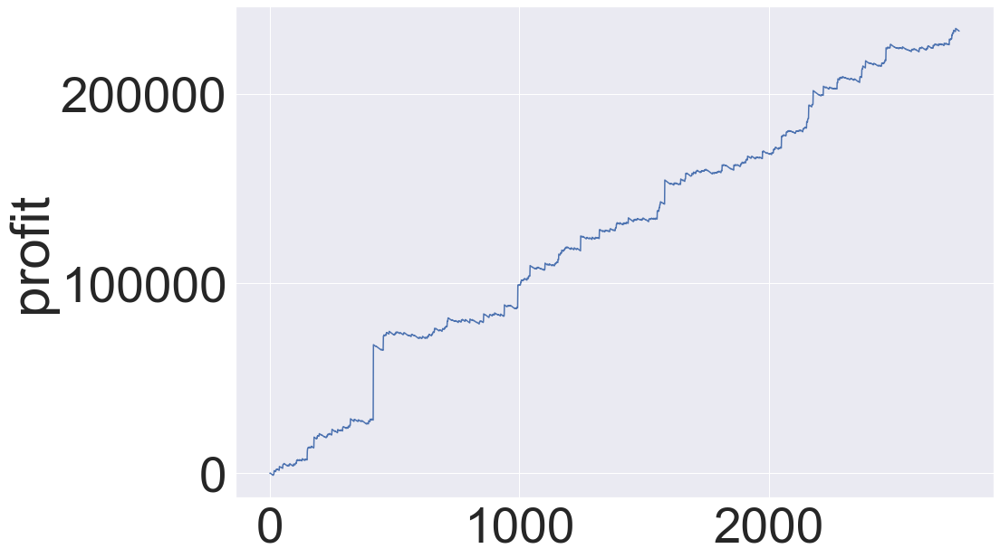

In [423]:
import matplotlib.pyplot as plt
plt.figure(figsize=(15,10))
sns.lineplot(y=result1['profit'].cumsum(), x=range(len(result1['profit'])))

In [424]:
result1[result1['profit']==result1['profit'].max()]

,race_id,rank,pred,correct,rank_first_odd,return,cost,profit
415,201805020301,1,0.004546,True,398.3,39830.0,100,39730.0


In [425]:
import matplotlib.pyplot as plt
def plotImp(model, num = 20, fig_size = (40, 20)):
    feature_imp = pd.DataFrame({'Value':model.feature_importance(),'Feature':model.feature_name()})
    plt.figure(figsize=fig_size)
    sns.set(font_scale = 5)
    sns.barplot(x="Value", y="Feature", data=feature_imp.sort_values(by="Value", 
                                                        ascending=False)[0:num])
    plt.title('LightGBM Features (avg over folds)')
    plt.tight_layout()
    plt.savefig('lgbm_importances-01.png')
    plt.show()

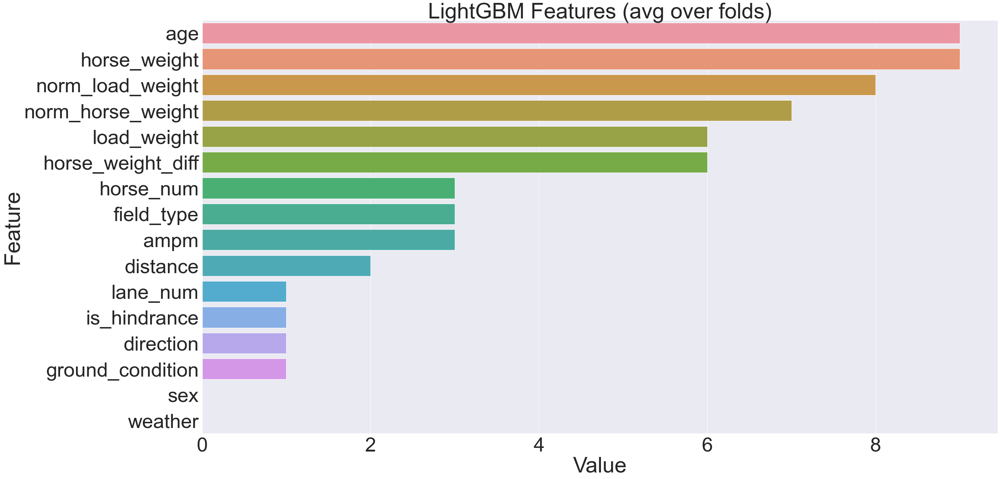

In [426]:
plotImp(model)

In [427]:
model.feature_importance()

array([1, 3, 6, 0, 9, 9, 6, 7, 8, 2, 1, 3, 1, 1, 0, 3], dtype=int32)

In [428]:
model.feature_name()

['lane_num',
 'horse_num',
 'load_weight',
 'sex',
 'age',
 'horse_weight',
 'horse_weight_diff',
 'norm_horse_weight',
 'norm_load_weight',
 'distance',
 'is_hindrance',
 'field_type',
 'direction',
 'ground_condition',
 'weather',
 'ampm']

<AxesSubplot:>

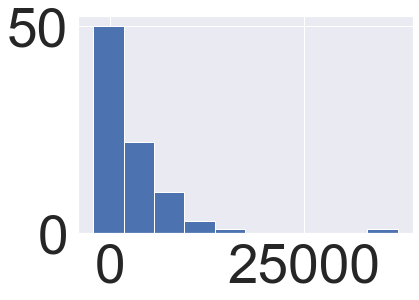

In [429]:
pd.merge(result1, data.groupby('race_id')['date'].first(), on='race_id', how='inner').groupby('date')['profit'].sum().hist()

In [437]:
pd.merge(result1, data.groupby('race_id')['date'].first(), on='race_id', how='inner').groupby('date')['profit'].sum().max()

37030.0

In [358]:
pd.merge(result1, data.groupby('race_id')['date'].first(), on='race_id', how='inner')[pd.merge(result1, data.groupby('race_id')['date'].first(), on='race_id', how='inner')['date']==pd.merge(result1, data.groupby('race_id')['date'].first(), on='race_id', how='inner').groupby('date')['profit'].sum().idxmax()]


,race_id,rank,pred,correct,rank_first_odd,return,cost,profit,date
1893,201706050401,4,0.004285,False,3.4,0.0,100,-100.0,2017-12-10
1894,201707040401,1,0.004285,True,21.0,2100.0,100,2000.0,2017-12-10
1895,201709050401,1,0.004285,True,130.3,13030.0,100,12930.0,2017-12-10
1896,201706050402,1,0.004285,True,1.5,150.0,100,50.0,2017-12-10
1897,201707040402,3,0.004285,False,9.5,0.0,100,-100.0,2017-12-10
1898,201709050402,1,0.004285,True,4.5,450.0,100,350.0,2017-12-10
1899,201706050403,1,0.004285,True,1.5,150.0,100,50.0,2017-12-10
1900,201707040403,6,0.004285,False,5.6,0.0,100,-100.0,2017-12-10
1901,201709050403,2,0.004285,False,9.2,0.0,100,-100.0,2017-12-10
1902,201706050404,1,0.004285,True,1.4,140.0,100,40.0,2017-12-10


In [361]:
data[data['race_id']=='201709050401']

,rank,lane_num,horse_num,horse_name,load_weight,jockey_name,time,rank_first_odd,popularity,sex,...,field_type,direction,ground_condition,weather,date,start_time,horse_id,jockey_id,rank_value,ampm
0,1,5,8,カタトゥンボ,55.0,松岡正海,00:01:13.800000,130.3,12,2,...,0,2,6,2,2017-12-10,10:05:00,2015105551,1085,10,0
1,2,8,14,マコトキッショウ,55.0,ルメール,00:01:14,5.7,2,2,...,0,2,6,2,2017-12-10,10:05:00,2015100562,5339,5,0
2,3,7,13,ビッグウェーブ,55.0,松田大作,00:01:14.400000,30.1,8,2,...,0,2,6,2,2017-12-10,10:05:00,2015103001,1030,3,0
3,4,8,15,メイショウヤシチ,55.0,池添謙一,00:01:14.800000,20.9,6,2,...,0,2,6,2,2017-12-10,10:05:00,2015100139,1032,0,0
4,5,3,4,ビーチキャンドル,54.0,水口優也,00:01:15.100000,14.9,4,1,...,0,2,6,2,2017-12-10,10:05:00,2015103081,1133,0,0
5,6,6,11,ウサギノダンス,55.0,高倉稜,00:01:15.200000,58.9,10,2,...,0,2,6,2,2017-12-10,10:05:00,2015103181,1130,0,0
6,7,2,3,メイショウパルサー,55.0,幸英明,00:01:15.300000,194.0,13,2,...,0,2,6,2,2017-12-10,10:05:00,2015103421,732,0,0
7,8,4,7,センスオブワンダー,55.0,Ｃ．デム,00:01:15.400000,7.3,3,2,...,0,2,6,2,2017-12-10,10:05:00,2015100597,5473,0,0
8,9,2,2,ヒロノオウカン,55.0,川島信二,00:01:15.400000,24.0,7,2,...,0,2,6,2,2017-12-10,10:05:00,2015105318,1062,0,0
9,10,5,9,ワンダーアグリコラ,54.0,小牧太,00:01:15.700000,64.0,11,1,...,0,2,6,2,2017-12-10,10:05:00,2015102437,894,0,0


In [350]:
pd.merge(result1, data.groupby('race_id')['date'].first(), on='race_id', how='inner').groupby('date')['profit'].sum()[pd.merge(result1, data.groupby('race_id')['date'].first(), on='race_id', how='inner').groupby('date')['profit'].sum().index==pd.merge(result1, data.groupby('race_id')['date'].first(), on='race_id', how='inner').groupby('date')['profit'].sum().idxmax()]

date
2017-12-10    17290.0
Name: profit, dtype: float64

In [316]:
pd.merge(result1, data[['race_id', 'date']], how='left', on='race_id')[pd.merge(result1, data[['race_id', 'date']], how='left', on='race_id')['date'] ==dt.date(2017,12,23)]['profit'].sum()

94080.0

In [277]:
data[data['race_id']=='201709050401']

,rank,lane_num,horse_num,horse_name,load_weight,jockey_name,time,rank_first_odd,popularity,sex,...,field_type,direction,ground_condition,weather,date,start_time,horse_id,jockey_id,rank_value,ampm
0,1,5,8,カタトゥンボ,55.0,松岡正海,00:01:13.800000,130.3,12,2,...,0,2,6,2,2017-12-10,10:05:00,2015105551,1085,10,0
1,2,8,14,マコトキッショウ,55.0,ルメール,00:01:14,5.7,2,2,...,0,2,6,2,2017-12-10,10:05:00,2015100562,5339,5,0
2,3,7,13,ビッグウェーブ,55.0,松田大作,00:01:14.400000,30.1,8,2,...,0,2,6,2,2017-12-10,10:05:00,2015103001,1030,3,0
3,4,8,15,メイショウヤシチ,55.0,池添謙一,00:01:14.800000,20.9,6,2,...,0,2,6,2,2017-12-10,10:05:00,2015100139,1032,0,0
4,5,3,4,ビーチキャンドル,54.0,水口優也,00:01:15.100000,14.9,4,1,...,0,2,6,2,2017-12-10,10:05:00,2015103081,1133,0,0
5,6,6,11,ウサギノダンス,55.0,高倉稜,00:01:15.200000,58.9,10,2,...,0,2,6,2,2017-12-10,10:05:00,2015103181,1130,0,0
6,7,2,3,メイショウパルサー,55.0,幸英明,00:01:15.300000,194.0,13,2,...,0,2,6,2,2017-12-10,10:05:00,2015103421,732,0,0
7,8,4,7,センスオブワンダー,55.0,Ｃ．デム,00:01:15.400000,7.3,3,2,...,0,2,6,2,2017-12-10,10:05:00,2015100597,5473,0,0
8,9,2,2,ヒロノオウカン,55.0,川島信二,00:01:15.400000,24.0,7,2,...,0,2,6,2,2017-12-10,10:05:00,2015105318,1062,0,0
9,10,5,9,ワンダーアグリコラ,54.0,小牧太,00:01:15.700000,64.0,11,1,...,0,2,6,2,2017-12-10,10:05:00,2015102437,894,0,0


In [430]:
import numpy as np
np.random.seed(1)
test_data.groupby('race_id')['rank'].apply(np.random.choice)

race_id
201801010101     6
201801010102    12
201801010103     9
201801010104    10
201801010105    12
                ..
201810021208    17
201810021209     3
201810021210     9
201810021211     6
201810021212     5
Name: rank, Length: 2764, dtype: int64

In [431]:
random_test=pd.merge(test_data.groupby('race_id')['rank'].apply(np.random.choice), data.groupby('race_id')['rank_first_odd'].first(), on='race_id')

In [432]:
random_test

,rank,rank_first_odd
race_id,,
201801010101,2,1.1
201801010102,7,2.1
201801010103,9,3.3
201801010104,10,4.3
201801010105,11,5.2
...,...,...
201810021208,17,27.5
201810021209,14,12.9
201810021210,14,4.7


In [433]:
random_test['correct'] = random_test['rank']==1

In [434]:
random_test.groupby('correct').agg('count')

,rank,rank_first_odd
correct,,
False,2559,2559
True,205,205


# We can see if we take blandly pick one horse as bench mark. We successfully beat the benchmark, with a nice profit for the 170k yen

In [6]:
from package.data import ResultData, RaceData
import pandas as pd
from tqdm.notebook import tqdm
import pandas_profiling as pp
import time
store= pd.HDFStore('/Users/jimmy/research/horse_racing_forecast/data/data.h5')
from package.analytics import analyze
from package.core import RaceTicket,TicketType

In [2]:
report = analyze([RaceTicket(race_id= '201309050911',ticket_type=TicketType.単勝, pattern=[10], bet=1),
RaceTicket(race_id= '201401010101',ticket_type=TicketType.ワイド, pattern=[10], bet=1),
RaceTicket(race_id= '201401010101',ticket_type=TicketType.単勝, pattern=[10], bet=1),
RaceTicket(race_id= '201601010101',ticket_type=TicketType.三連単, pattern=[10,12,9], bet=1)],store)

In [3]:
report

,race_id,ticket,date,start_time,cost,return
0,201309050911,"Race: 201309050911, Type:単勝, Patter:10",2013年12月23日,15:45,100,1540
1,201401010101,"Race: 201401010101, Type:ワイド, Patter:10",2014年7月26日,09:55,100,0
2,201401010101,"Race: 201401010101, Type:単勝, Patter:10",2014年7月26日,09:55,100,0
3,201601010101,"Race: 201601010101, Type:三連単, Patter:10→12→9",2016年7月30日,09:55,100,0


In [19]:
type(store)

pandas.io.pytables.HDFStore

In [8]:
profile = pp.ProfileReport(report)

In [18]:
pd.read_hdf(store, key='race',table=True, mode='r').profile_report()

Render HTML: 100%|██████████| 1/1 [00:09<00:00,  9.66s/it]


In [17]:
profile.to_notebook_iframe()